In [3]:
import itertools
import numpy as np
import os
import seaborn as sns
from tqdm import tqdm
from dataclasses import asdict, dataclass, field
import vsketch
import shapely.geometry as sg
from shapely.geometry import box, MultiLineString, Point, MultiPoint, Polygon, MultiPolygon, LineString
import shapely.affinity as sa
import shapely.ops as so
import matplotlib.pyplot as plt
import pandas as pd

from PIL import Image

import vpype_cli
from typing import List, Generic
from genpen import genpen as gp, utils as utils
from scipy import stats as ss
import geopandas
from shapely.errors import TopologicalError
import functools
from genpen.flow.field import PerlinGrid
from genpen.flow.particle import VectorParticle
%load_ext autoreload
%autoreload 2

from sklearn.preprocessing import minmax_scale

In [4]:
paper_size = '11x14 inches'
border:float=30
paper = utils.Paper(paper_size)

drawbox = paper.get_drawbox(border)
buffer_style = 2

In [5]:
k = gabor_kernel(
    frequency=0.2,
    theta=np.pi*0.5,
    bandwidth=1,
    sigma_x=3,
    sigma_y=3,
    n_stds=2,
    offset=0
)
k = np.real(k)
k = minmax_scale(k) * 255
resize_factor = 16
img = Image.fromarray(k.astype(np.uint8))
new_size = [s*resize_factor for s in img.size]
img.resize(new_size)

NameError: name 'gabor_kernel' is not defined

Rotated images matched against references using Gabor filter banks:
original: brick, rotated: 30deg, match result: brick
original: brick, rotated: 70deg, match result: brick
original: grass, rotated: 145deg, match result: brick


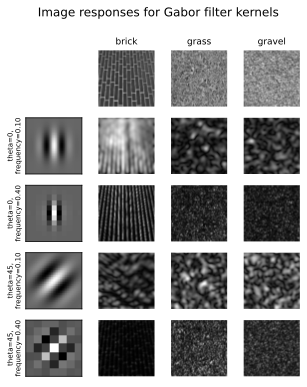

In [6]:
from scipy import ndimage as ndi

from skimage import data
from skimage.util import img_as_float
from skimage.filters import gabor_kernel


def compute_feats(image, kernels):
    feats = np.zeros((len(kernels), 2), dtype=np.double)
    for k, kernel in enumerate(kernels):
        filtered = ndi.convolve(image, kernel, mode='wrap')
        feats[k, 0] = filtered.mean()
        feats[k, 1] = filtered.var()
    return feats


def match(feats, ref_feats):
    min_error = np.inf
    min_i = None
    for i in range(ref_feats.shape[0]):
        error = np.sum((feats - ref_feats[i, :])**2)
        if error < min_error:
            min_error = error
            min_i = i
    return min_i


# prepare filter bank kernels
kernels = []
for theta in range(4):
    theta = theta / 4. * np.pi
    for sigma in (1, 3):
        for frequency in (0.05, 0.25):
            kernel = np.real(gabor_kernel(frequency, theta=theta,
                                          sigma_x=sigma, sigma_y=sigma))
            kernels.append(kernel)


shrink = (slice(0, None, 3), slice(0, None, 3))
brick = img_as_float(data.brick())[shrink]
grass = img_as_float(data.grass())[shrink]
gravel = img_as_float(data.gravel())[shrink]
image_names = ('brick', 'grass', 'gravel')
images = (brick, grass, gravel)

# prepare reference features
ref_feats = np.zeros((3, len(kernels), 2), dtype=np.double)
ref_feats[0, :, :] = compute_feats(brick, kernels)
ref_feats[1, :, :] = compute_feats(grass, kernels)
ref_feats[2, :, :] = compute_feats(gravel, kernels)

print('Rotated images matched against references using Gabor filter banks:')

print('original: brick, rotated: 30deg, match result: ', end='')
feats = compute_feats(ndi.rotate(brick, angle=190, reshape=False), kernels)
print(image_names[match(feats, ref_feats)])

print('original: brick, rotated: 70deg, match result: ', end='')
feats = compute_feats(ndi.rotate(brick, angle=70, reshape=False), kernels)
print(image_names[match(feats, ref_feats)])

print('original: grass, rotated: 145deg, match result: ', end='')
feats = compute_feats(ndi.rotate(grass, angle=145, reshape=False), kernels)
print(image_names[match(feats, ref_feats)])


def power(image, kernel):
    # Normalize images for better comparison.
    image = (image - image.mean()) / image.std()
    return np.sqrt(ndi.convolve(image, np.real(kernel), mode='wrap')**2 +
                   ndi.convolve(image, np.imag(kernel), mode='wrap')**2)

# Plot a selection of the filter bank kernels and their responses.
results = []
kernel_params = []
for theta in (0, 1):
    theta = theta / 4. * np.pi
    for frequency in (0.1, 0.4):
        kernel = gabor_kernel(frequency, theta=theta)
        params = 'theta=%d,\nfrequency=%.2f' % (theta * 180 / np.pi, frequency)
        kernel_params.append(params)
        # Save kernel and the power image for each image
        results.append((kernel, [power(img, kernel) for img in images]))

fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(5, 6))
plt.gray()

fig.suptitle('Image responses for Gabor filter kernels', fontsize=12)

axes[0][0].axis('off')

# Plot original images
for label, img, ax in zip(image_names, images, axes[0][1:]):
    ax.imshow(img)
    ax.set_title(label, fontsize=9)
    ax.axis('off')

for label, (kernel, powers), ax_row in zip(kernel_params, results, axes[1:]):
    # Plot Gabor kernel
    ax = ax_row[0]
    ax.imshow(np.real(kernel))
    ax.set_ylabel(label, fontsize=7)
    ax.set_xticks([])
    ax.set_yticks([])

    # Plot Gabor responses with the contrast normalized for each filter
    vmin = np.min(powers)
    vmax = np.max(powers)
    for patch, ax in zip(powers, ax_row[1:]):
        ax.imshow(patch, vmin=vmin, vmax=vmax)
        ax.axis('off')

plt.show()

In [56]:
# https://github.com/expyriment/expyriment-stash/blob/master/extras/expyriment_stimuli_extras/gaborpatch/_gaborpatch.py

class GaborPatch(object):
    """A class implementing a Gabor Patch."""

    def __init__(self,
                 sigma=55,
                 theta=35,  # degrees
                 lambda_=12.5,
                 amplitude=0.5,
                 phase=120,  # degrees
                 gamma=1,
                 nstds = 3,
                 background_colour=(127, 127, 127)
                 ):
        """Create a Gabor Patch.
        Parameters
        ----------
        position  : (int, int), optional
            position of the mask stimulus
        sigma : int or float, optional
            gaussian standard deviation (in pixels) (default=20)
        theta : int or float, optional
            Grating orientation in degrees (default=35)
        lambda_ : int, optional
            Spatial frequency (pixel per cycle) (default=10)
        amplitude : float
            0 to 1 inclusive (default=.5)
        phase : int, optional
            0 to 1 inclusive (default=1)
        gamma : float
            0 to 1 inclusive (default=1)
        background_colour : (int,int,int), optional
            colour of the background, default: (127, 127, 127)
        Notes
        -----
        The background colour of the stimulus depends of the parameters of
        the Gabor patch and can be determined (e.g. for plotting) with the
        property `GaborPatch.background_colour`.
        """



        sigma_x = sigma
        sigma_y = float(sigma) / gamma

        phase = phase / 180.0 * np.pi
        theta = theta / 180.0 * np.pi
        # Bounding box
        
        
        xmax = max(abs(nstds * sigma_x * np.cos(theta)), abs(nstds * sigma_y * np.sin(theta)))
        xmax = np.ceil(max(1, xmax))
        ymax = max(abs(nstds * sigma_x * np.sin(theta)), abs(nstds * sigma_y * np.cos(theta)))
        ymax = np.ceil(max(1, ymax))
        xmin = -xmax
        ymin = -ymax
        (x, y) = np.meshgrid(np.arange(xmin, xmax + 1), np.arange(ymin, ymax + 1))
        (y, x) = np.meshgrid(np.arange(ymin, ymax + 1), np.arange(xmin, xmax + 1))

        # Rotation
        x_theta = x * np.cos(theta) + y * np.sin(theta)
        y_theta = -x * np.sin(theta) + y * np.cos(theta)

        pattern = np.exp(-.5 * (x_theta ** 2 / sigma_x ** 2 + y_theta ** 2 / sigma_y ** 2)) * np.cos(
            2 * np.pi / lambda_ * x_theta + phase)
        
        # make numpy pixel array
        bkg = np.ones((pattern.shape[0], pattern.shape[1], 3)) * \
                                    (np.ones((pattern.shape[1], 3)) * background_colour) #background
        modulation = np.ones((3, pattern.shape[1], pattern.shape[0])) * \
                                    ((255/2.0) * amplitude * np.ones(pattern.shape) * pattern)  # alpha

        self._pixel_array = bkg + modulation.T
        self._pixel_array[self._pixel_array<0] = 0
        self._pixel_array[self._pixel_array>255] = 255
        

    @property
    def background_colour(self):
        """Getter for background_colour"""

        return self._background_colour


    @property
    def pixel_array(self):
        """Getter for pixel_array"""

        return self._pixel_array

    def _create_surface(self):
        """Get the surface of the stimulus.
        This method has to be overwritten for all subclasses individually!
        """

        self.set_surface(self._pixel_array)
        return self._surface

In [239]:
sigma=8
theta=35  # degrees
lambda_=10.5
amplitude=0.5
phase=120  # degrees
gamma=0.5
nstds = 2
background_colour=(127, 127, 127)
bbox_size=(24, 12)

In [300]:
class Gabor2(object):
    """A class implementing a Gabor Patch."""

    def __init__(self,
                 sigma=55,
                 theta=35,  # degrees
                 lambda_=12.5,
                 amplitude=0.5,
                 phase=120,  # degrees
                 gamma=1,
                 nstds = 3,
                 background_colour=(127, 127, 127),
                 bbox_size=(24, 12),
                 ):
        """Create a Gabor Patch.
        Parameters
        ----------
        position  : (int, int), optional
            position of the mask stimulus
        sigma : int or float, optional
            gaussian standard deviation (in pixels) (default=20)
        theta : int or float, optional
            Grating orientation in degrees (default=35)
        lambda_ : int, optional
            Spatial frequency (pixel per cycle) (default=10)
        amplitude : float
            0 to 1 inclusive (default=.5)
        phase : int, optional
            0 to 1 inclusive (default=1)
        gamma : float
            0 to 1 inclusive (default=1)
        background_colour : (int,int,int), optional
            colour of the background, default: (127, 127, 127)
        Notes
        -----
        The background colour of the stimulus depends of the parameters of
        the Gabor patch and can be determined (e.g. for plotting) with the
        property `GaborPatch.background_colour`.
        """

        self.background_color = background_colour

        sigma_x = sigma
        sigma_y = float(sigma)

        phase = phase / 180.0 * np.pi
        theta = theta / 180.0 * np.pi

        # Bounding box
        xmax = max(abs(nstds * sigma_x * np.cos(theta)), abs(nstds * sigma_y * np.sin(theta)))
        xmax = np.ceil(max(1, xmax))
        ymax = max(abs(nstds * sigma_x * np.sin(theta)), abs(nstds * sigma_y * np.cos(theta)))
        ymax = np.ceil(max(1, ymax))
        xmin = -xmax
        ymin = -ymax

        (x, y) = np.meshgrid(np.arange(xmin, xmax + 1), np.arange(ymin, ymax + 1) * gamma)
        pattern = np.exp(-.5 * (x ** 2 / sigma_x ** 2 + y ** 2 / sigma_y ** 2)) * np.cos(
            2 * np.pi / lambda_ * x + phase)
        bkg = np.ones_like(pattern)
        bkg = bkg[:,:,None] @ np.array(background_colour)[None, :]

        modulation = pattern[:,:,None] * amplitude @ np.array(background_colour)[None, :]
        self.pixel_array = bkg + modulation
        self.pixel_array[self.pixel_array<0] = 0
        self.pixel_array[self.pixel_array>255] = 255
        self.pixel_array = self.pixel_array.astype(np.uint8)

        self.orig_img = Image.fromarray(self.pixel_array)
        self.resized_img = self.orig_img.resize(bbox_size)
        self.rotated_img = self.resized_img.rotate(np.degrees(theta), expand=True, fillcolor=self.background_color)
    
    @property
    def array(self):
        return np.array(self.rotated_img)
        
        


In [301]:
gp = Gabor2(
    sigma=8,
    theta=45,
    lambda_=10.5, 
    amplitude=10,
    phase=120,  # degrees
    gamma=1,
    nstds = 2,
    background_colour=(127, 127, 127),
    bbox_size=(24, 12),
)

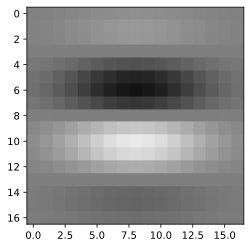

In [57]:
gp = GaborPatch(
    sigma=4,
    theta=90,
    lambda_=10,
    amplitude=1,
    phase=270, 
    gamma=1,  # xy asymmetry?
    nstds = 1.8,
    background_colour=(127, 127, 127),
)
plt.imshow(gp.pixel_array.astype(int))

## try 1

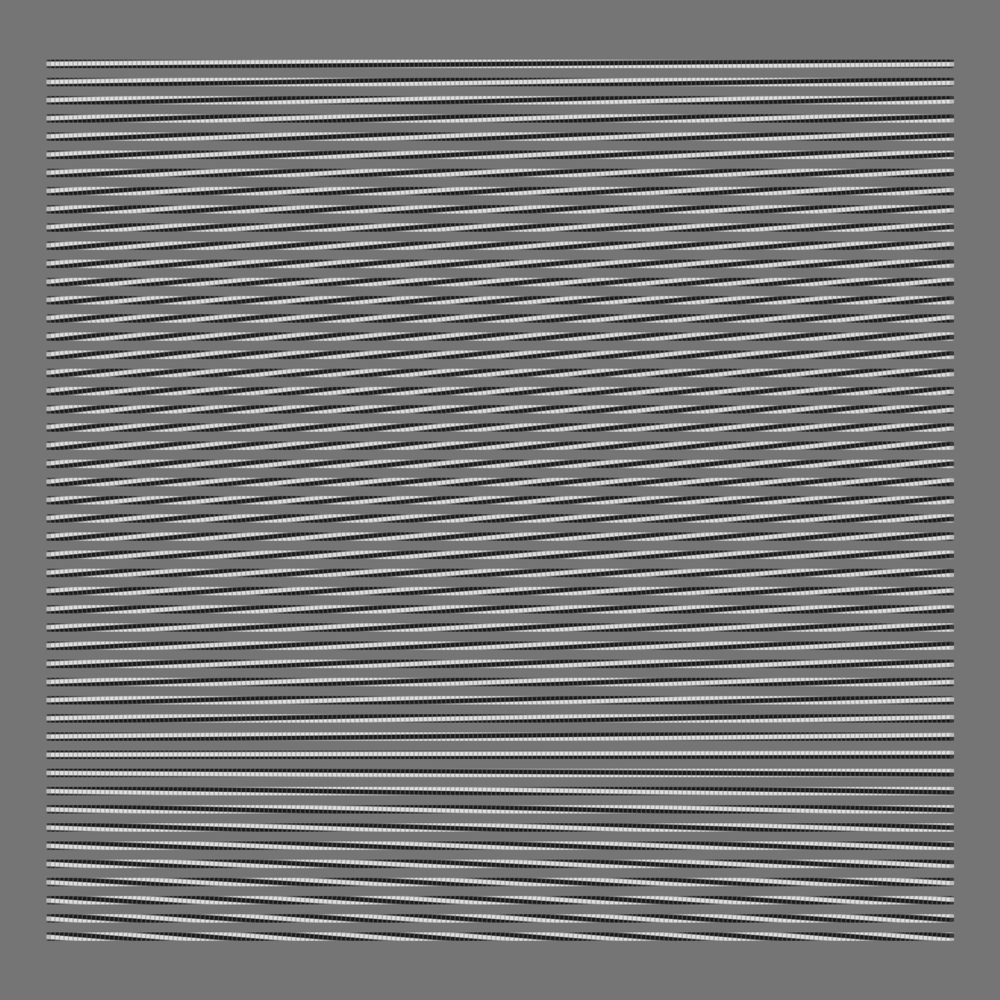

In [295]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * 117
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 10
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 40
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)

phase = 0
phase_random_walk_dist = ss.norm(loc=0, scale=2)

for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    # phase_freq_mod = np.sin(rel_y * 3) + 2
    # phase = np.sin(rel_x * phase_freq_mod) * 360
    phase_freq_mod = np.sin(rel_y * 4) * 4
    phase = rel_x * 1080 * phase_freq_mod
    gp = GaborPatch(
        sigma=5,
        theta=90,
        lambda_=20,
        amplitude=8,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1.8,
        background_colour=(127, 127, 127),
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    gp.pixel_array[:, 0, :] = 127
    gp.pixel_array[:, -1, :] = 127
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
Image.fromarray(base.astype(np.uint8))

In [346]:
db_width / x_spacing

400.0

In [347]:
db_height / y_spacing

25.0

## try 2

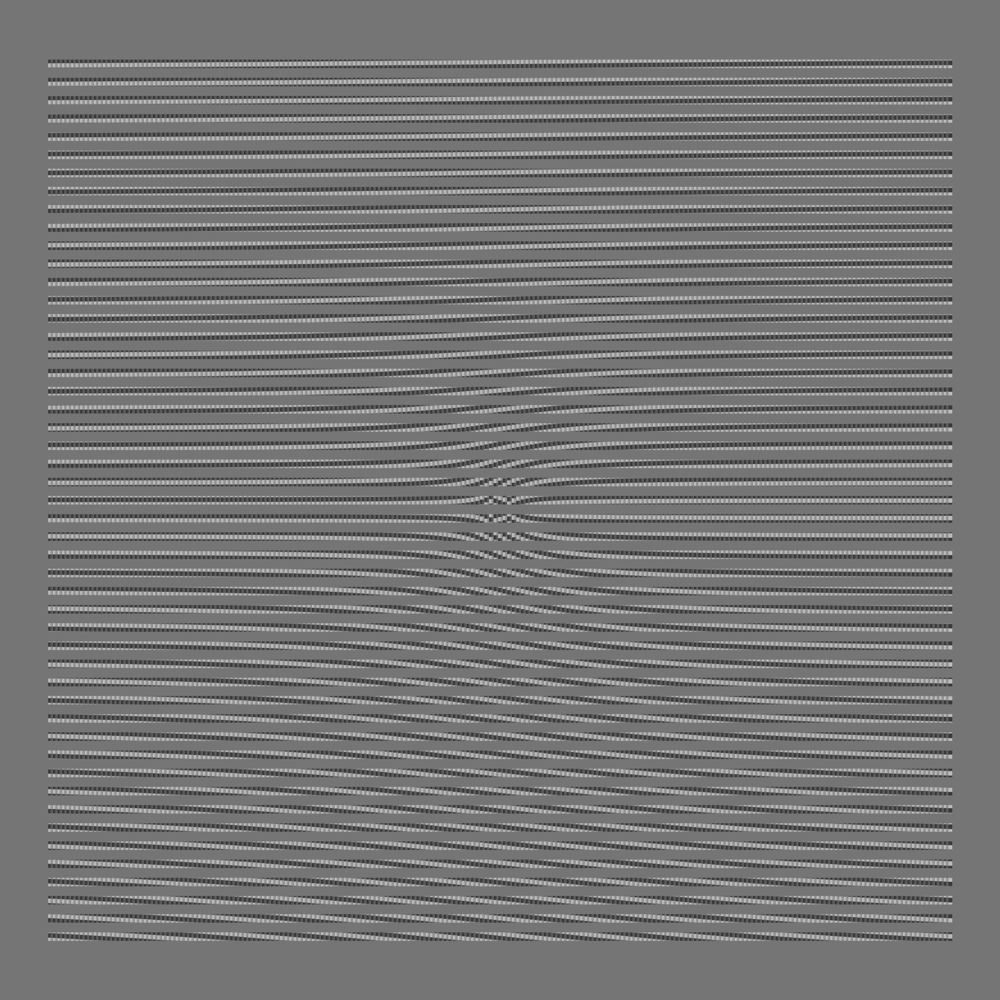

In [414]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 10
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 40
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)


for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    # phase_freq_mod = np.sin(rel_y * 3) + 2
    # phase = np.sin(rel_x * phase_freq_mod) * 360
    phase_freq_mod = np.sin(rel_y * 2) 
    phase = np.arctan2((rel_y - 0.51), (rel_x - 0.5)) * 180 * (rel_y **2  * 10 + 1)
    # phase += np.sin(rel_y**2) + np.cos(rel_x * 5) ** 2
    gp = GaborPatch(
        sigma=5,
        theta=90,
        lambda_=20,
        amplitude=8,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1.8,
        background_colour=[bg_color]*3,
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    gp.pixel_array[:, :5, :] = bg_color
    gp.pixel_array[:, -5:, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

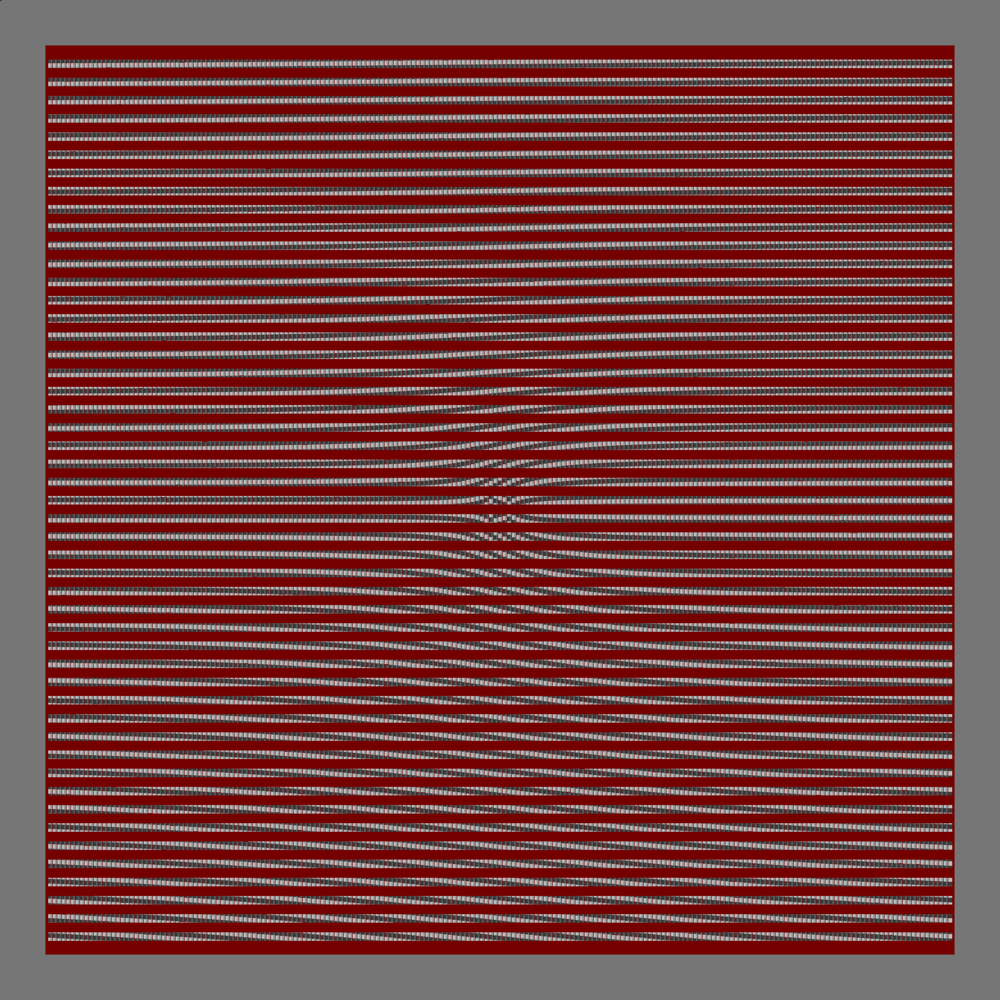

In [420]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 0
Image.fromarray(base_copy)


## try 3

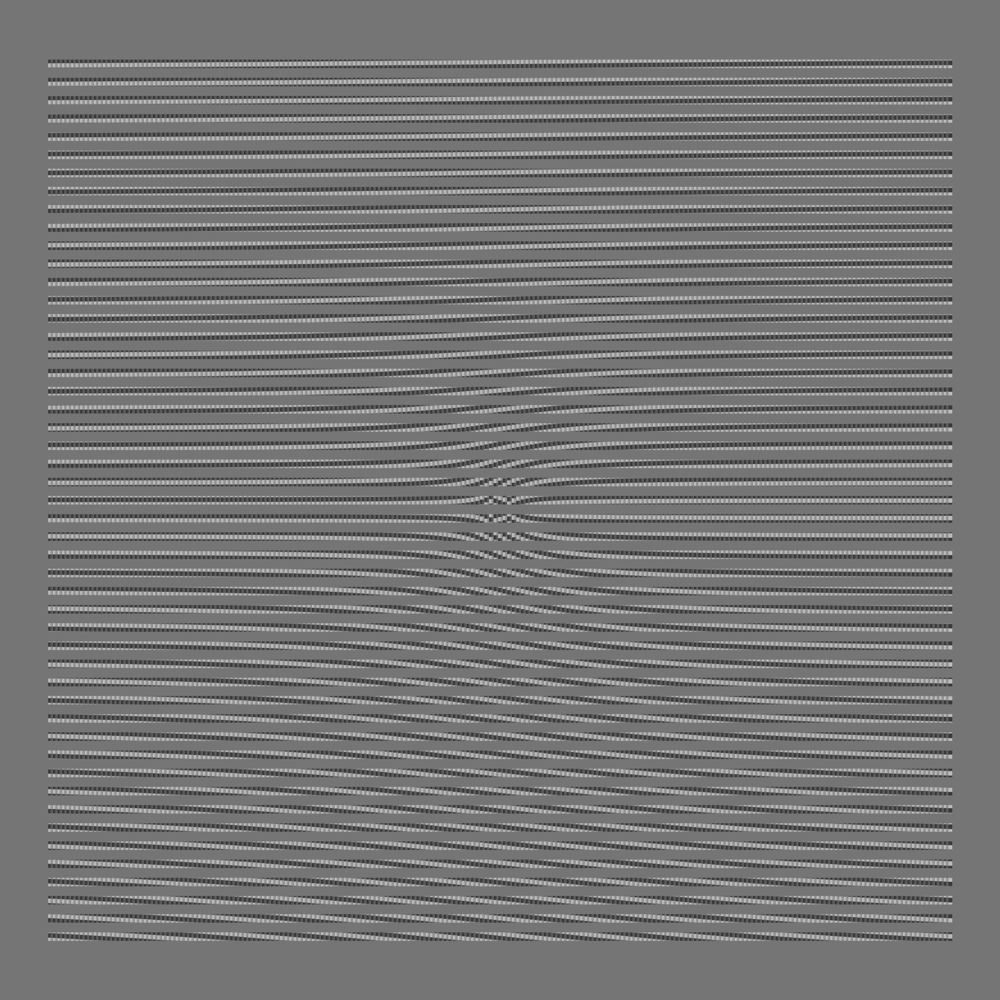

In [ ]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 10
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 40
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)


for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    # phase_freq_mod = np.sin(rel_y * 3) + 2
    # phase = np.sin(rel_x * phase_freq_mod) * 360
    phase_freq_mod = np.sin(rel_y * 2) 
    phase = np.arctan2((rel_y - 0.51), (rel_x - 0.5)) * 180 * (rel_y **2  * 10 + 1)
    # phase += np.sin(rel_y**2) + np.cos(rel_x * 5) ** 2
    gp = GaborPatch(
        sigma=5,
        theta=90,
        lambda_=20,
        amplitude=8,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1.8,
        background_colour=[bg_color]*3,
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    gp.pixel_array[:, :5, :] = bg_color
    gp.pixel_array[:, -5:, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

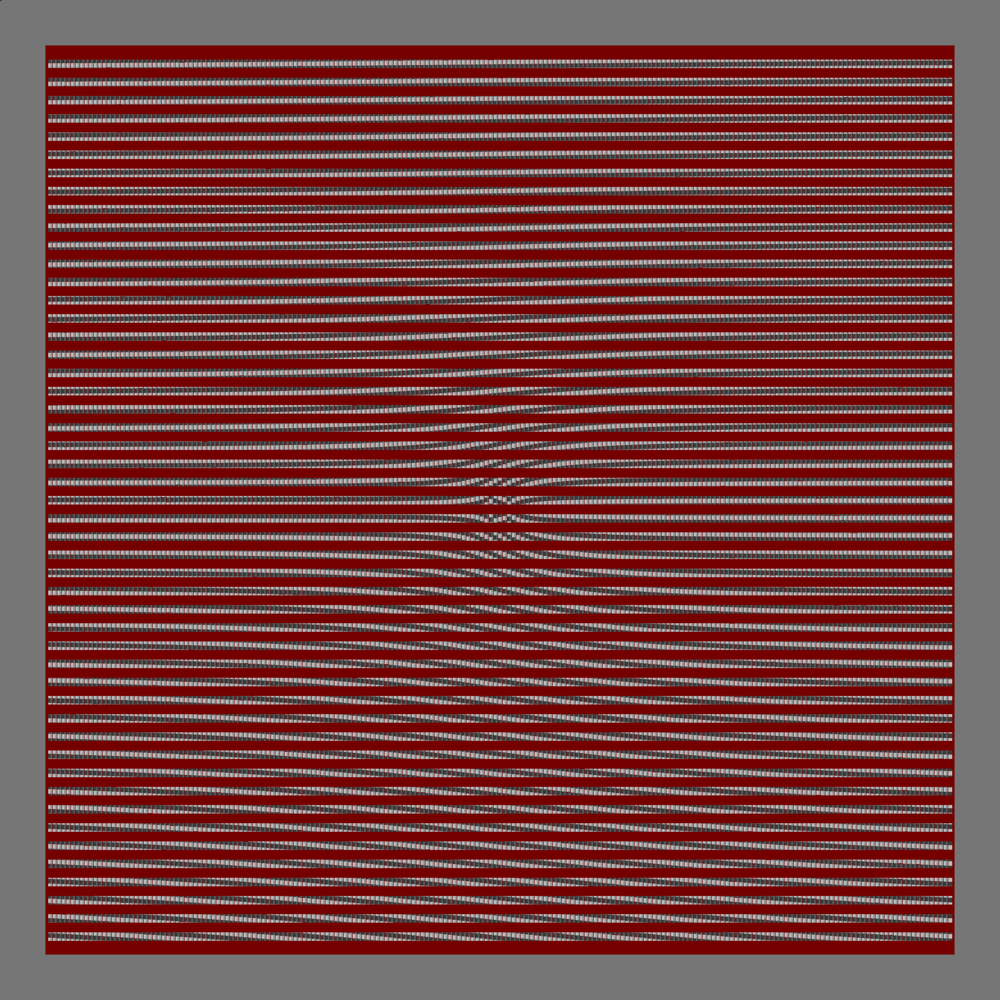

In [ ]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 0
Image.fromarray(base_copy)


## try 4

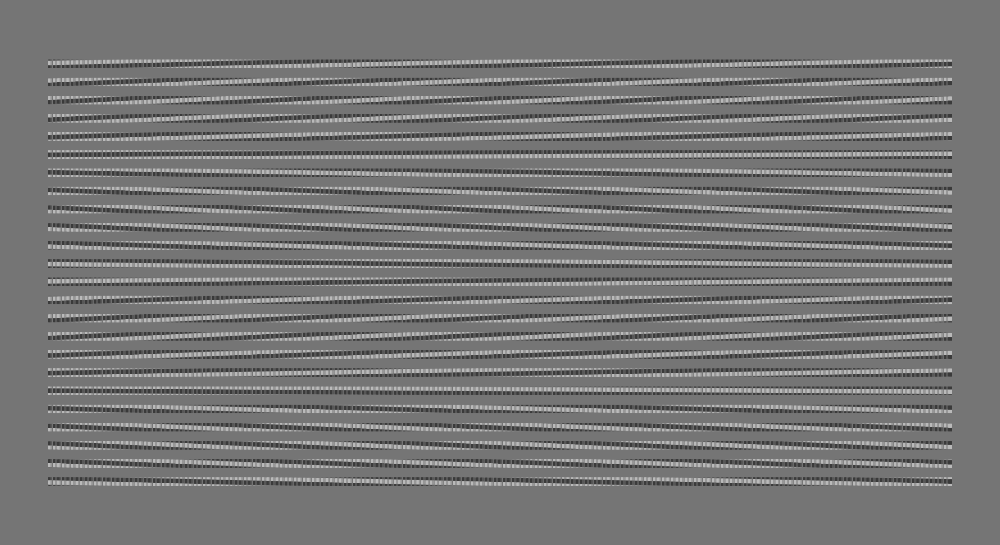

In [432]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 10
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 40
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)


for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    phase_freq_mod = 5 * np.sin(rel_y * np.pi * 4)
    phase = rel_x * 360 * phase_freq_mod + rel_y * 720
    # phase += np.sin(rel_y**2) + np.cos(rel_x * 5) ** 2
    gp = GaborPatch(
        sigma=5,
        theta=90,
        lambda_=20,
        amplitude=8,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1.8,
        background_colour=[bg_color]*3,
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    gp.pixel_array[:, :5, :] = bg_color
    gp.pixel_array[:, -5:, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

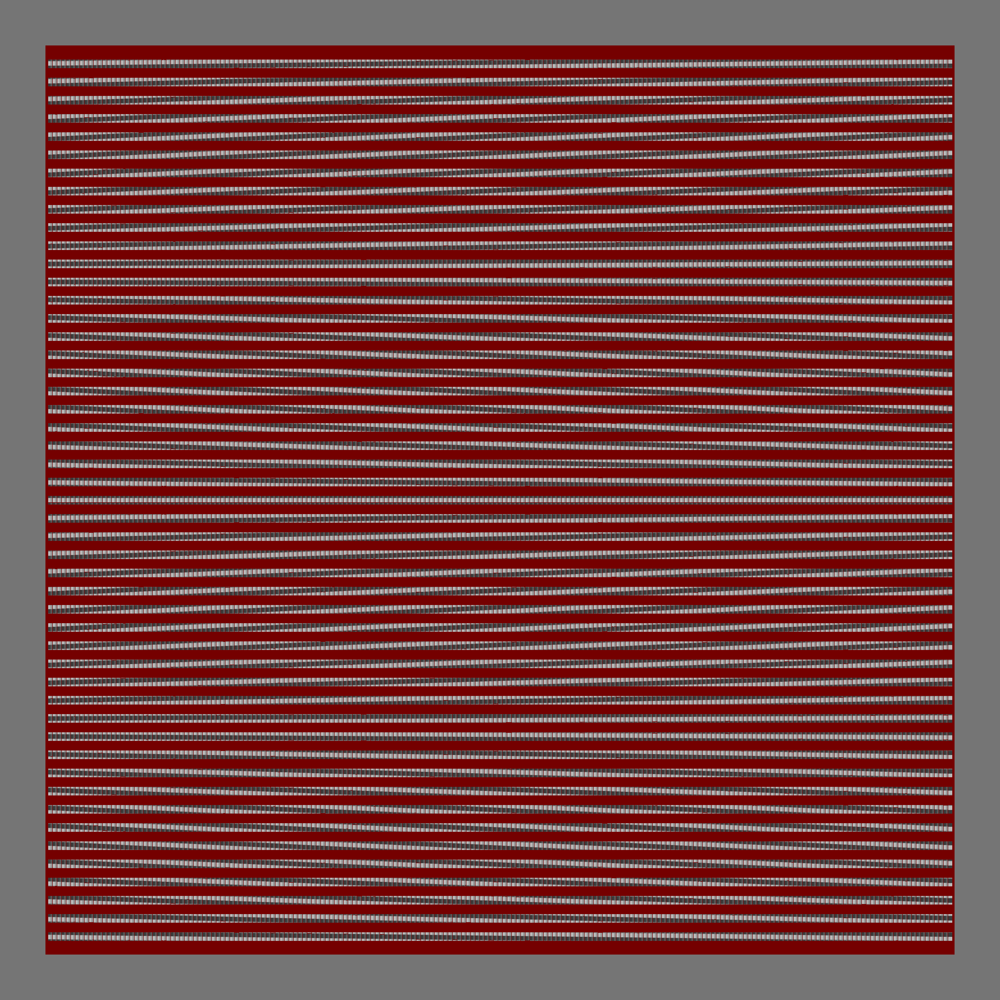

In [430]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 0
Image.fromarray(base_copy)


## try 5

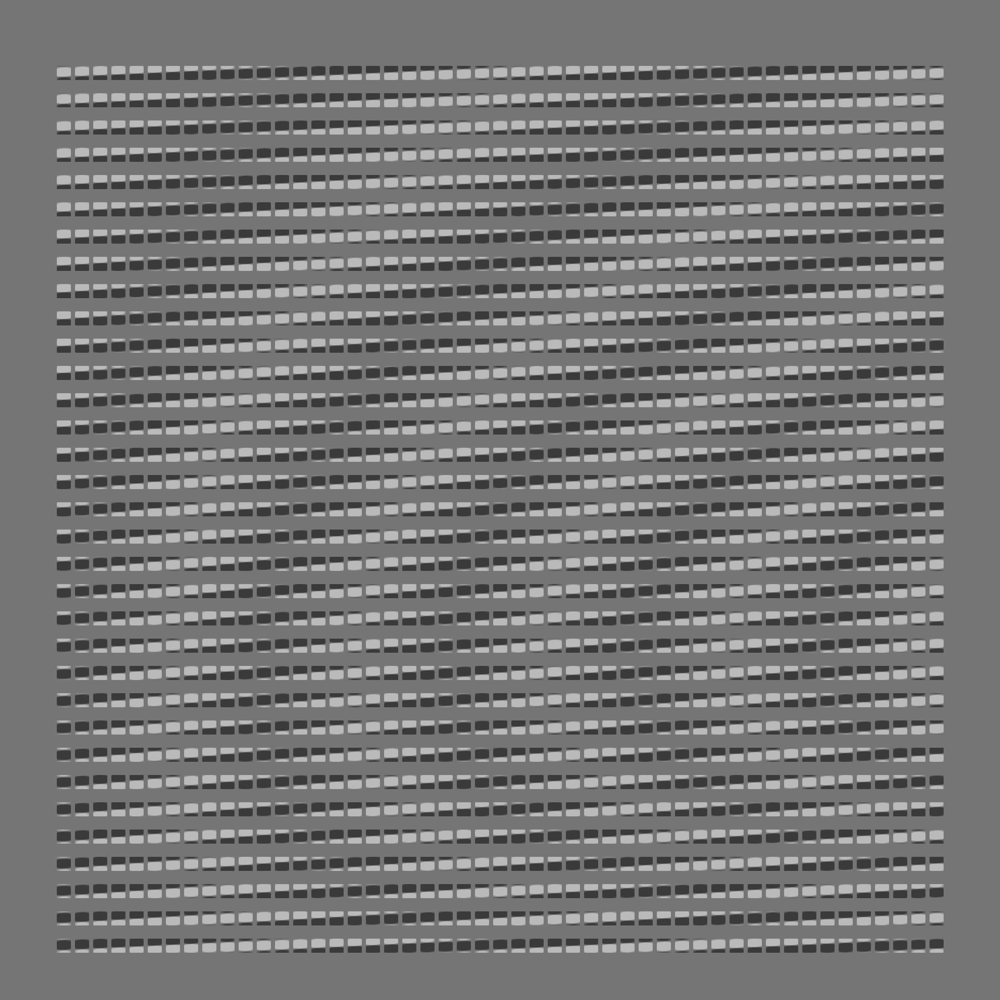

In [488]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 40
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 60
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)


for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    phase_freq_mod = 2 + np.sin(rel_y * np.pi) * rel_y * 5
    phase = rel_x * 360 * phase_freq_mod + rel_y * 180
    gp = GaborPatch(
        sigma=10,
        theta=88,
        lambda_=45,
        amplitude=7,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=2,
        background_colour=[bg_color]*3,
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    clip_d = 5
    gp.pixel_array[:, :clip_d, :] = bg_color
    gp.pixel_array[:, -clip_d:, :] = bg_color
    gp.pixel_array[:clip_d, :, :] = bg_color
    gp.pixel_array[-clip_d:, :, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

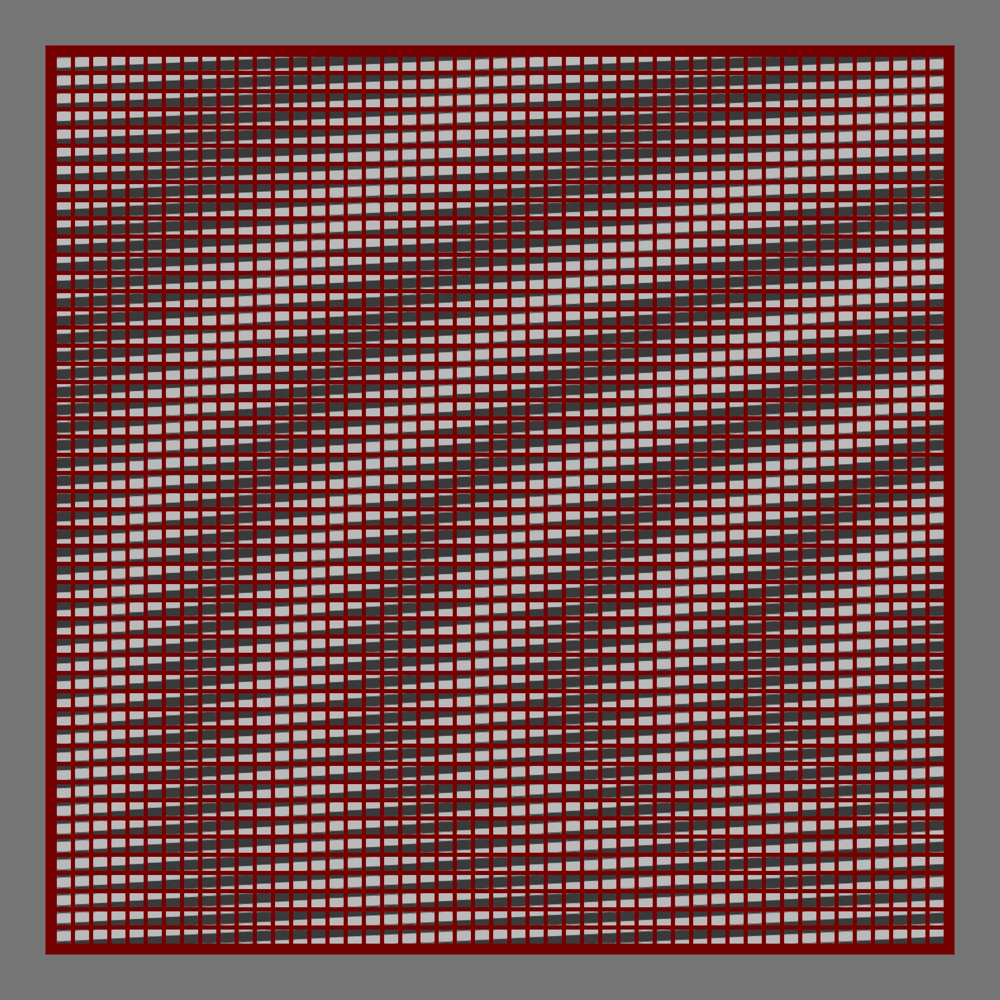

In [486]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 0
Image.fromarray(base_copy)


## try 6

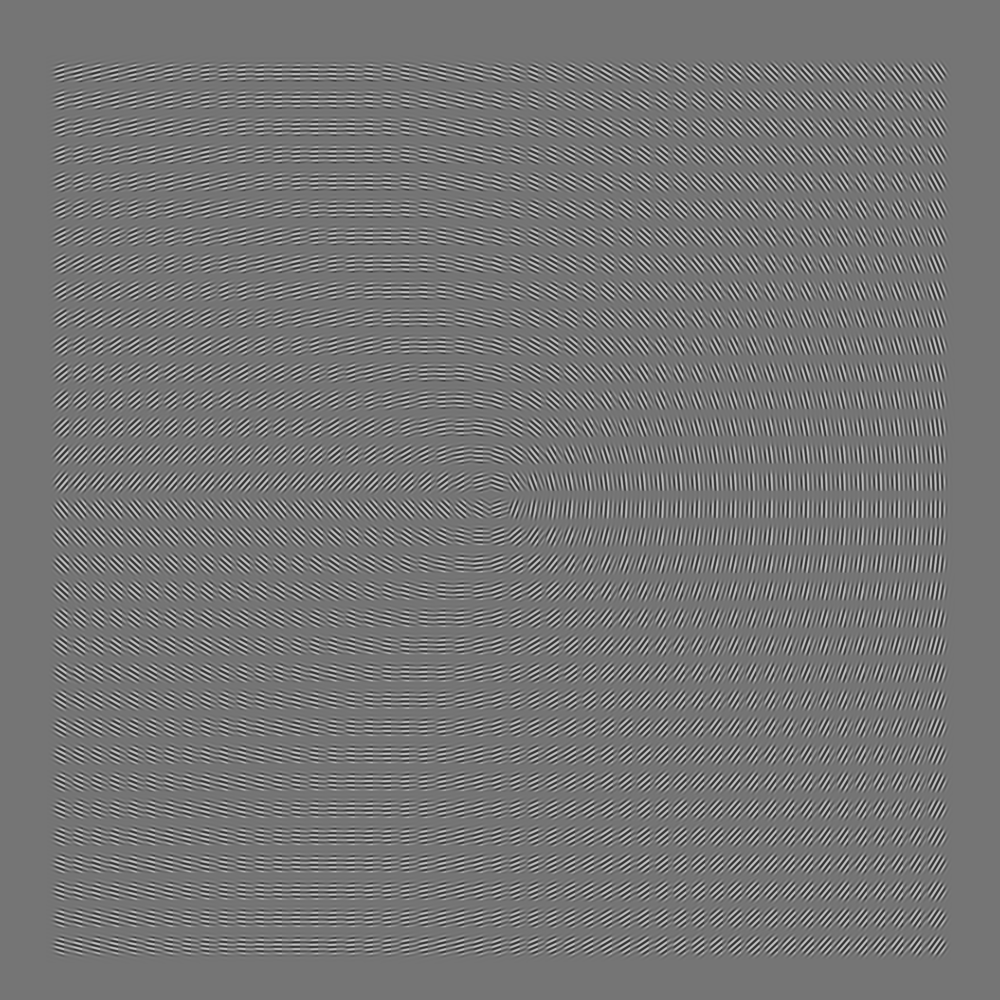

In [516]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2

base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color
center = np.array([int(d/2) for d in base.shape[:2]])

x_spacing = 40
x_centers = np.arange(x_spacing+xpad, db_width+xpad, x_spacing)

y_spacing = 60
y_centers = np.arange(y_spacing+ypad, db_height+ypad, y_spacing)


for y, x in itertools.product(y_centers, x_centers):

    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    phase = np.arctan2((rel_y - 0.51), (rel_x - 0.5)) * 180
    phase = 90
    theta = np.arctan2((rel_y - 0.5), (rel_x - 0.5)) * 45 + 0
    gp = GaborPatch(
        sigma=10,
        theta=theta,
        lambda_=10,
        amplitude=5,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=4,
        background_colour=[bg_color]*3,
    )
    
    left = x - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = y - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    clip_d = 1
    gp.pixel_array[:, :clip_d, :] = bg_color
    gp.pixel_array[:, -clip_d:, :] = bg_color
    gp.pixel_array[:clip_d, :, :] = bg_color
    gp.pixel_array[-clip_d:, :, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

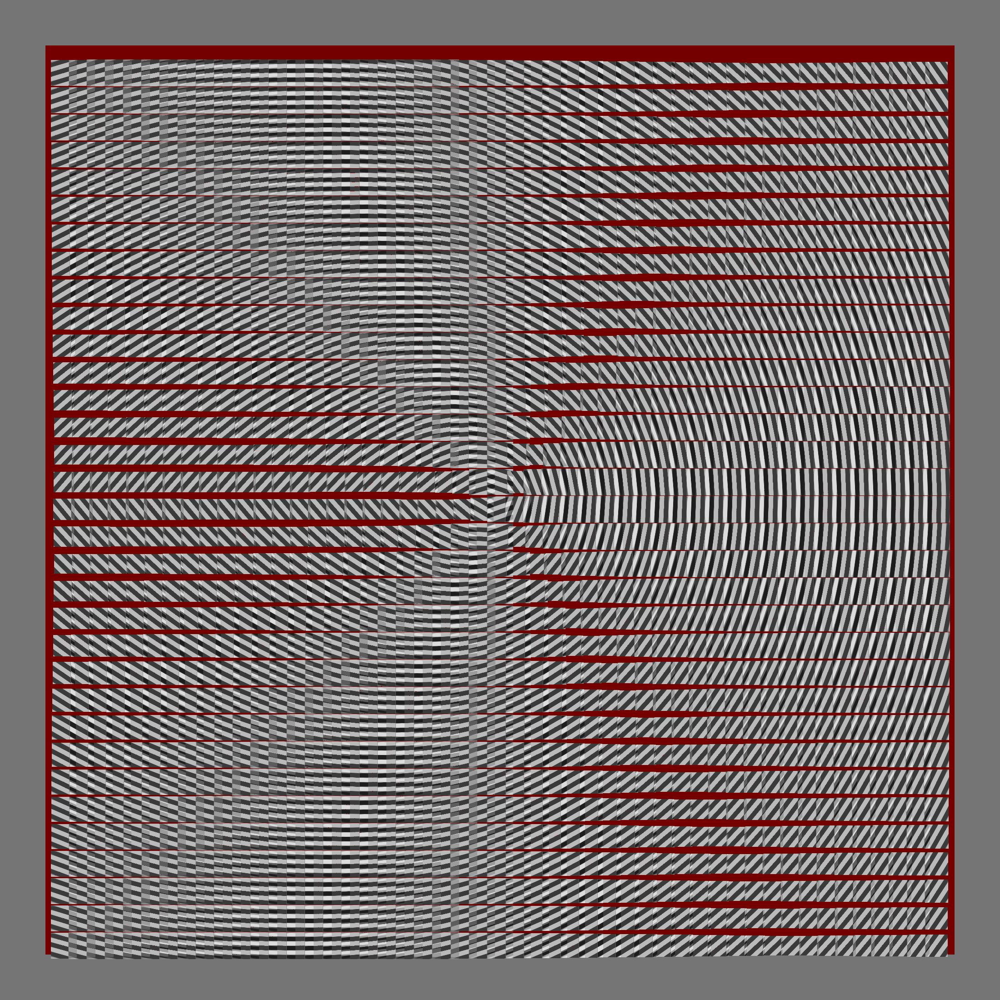

In [508]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 0
Image.fromarray(base_copy)


# radial point

In [298]:
import attr
class RadialPoint(object):

    def __init__(
        self,
        rad,
        theta,
        ):
    
        self.rad = rad
        self.theta = theta

    @property
    def x(self):
        return self.rad * np.cos(self.theta)

    @property
    def y(self):
        return self.rad * np.sin(self.theta)

    @property
    def pt(self):
        return Point(self.x, self.y)

## try 7

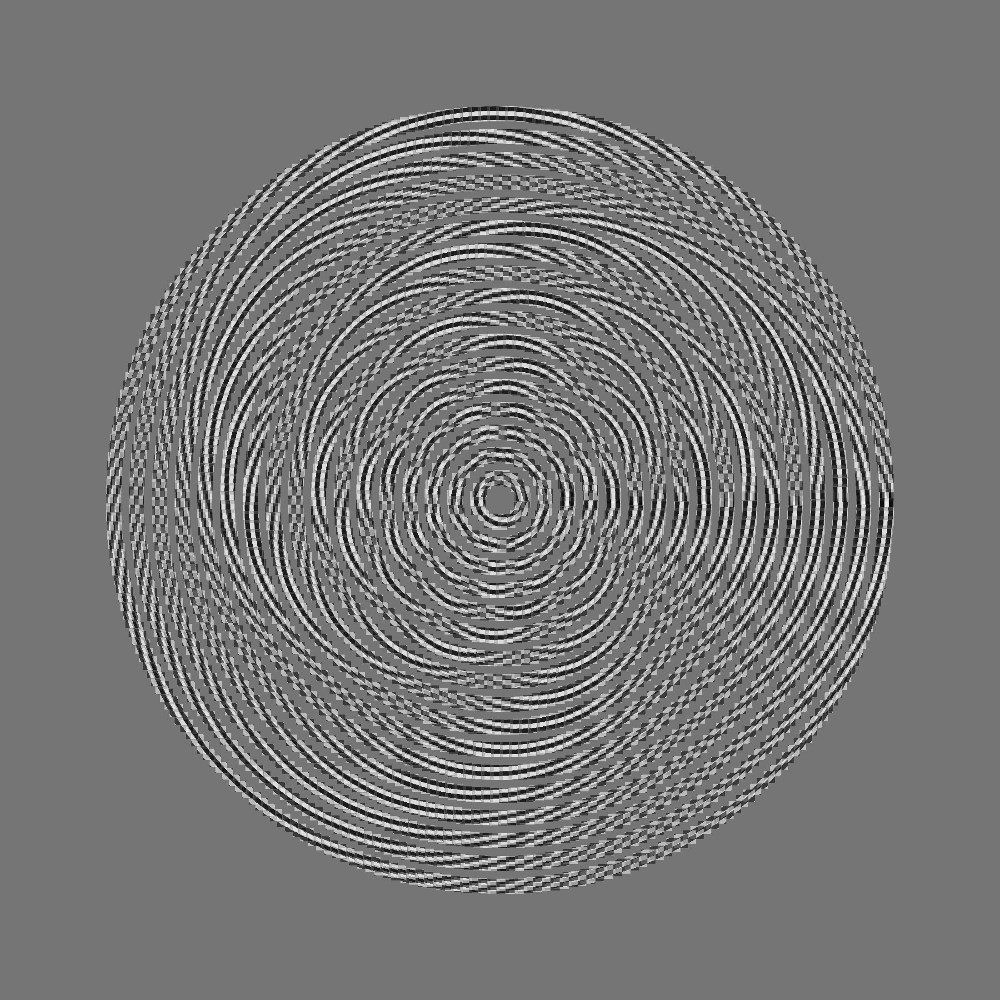

In [176]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2


base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color

center = np.array([int(d/2) for d in base.shape[:2]])

perim_spacing = 20

rads = np.arange(50, 900, 50)
centers = []
rpts = []
for rad in rads:
    circumference = np.pi * 2 * rad 
    thetas = np.arange(0, circumference, perim_spacing) / rad
    rpts += [RadialPoint(rad=rad, theta=theta) for theta in thetas]
        


for rpt in rpts:
    pt = sa.translate(rpt.pt, xoff=center[0], yoff=center[1])
    x = pt.x
    y = pt.y
    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    phase = np.arctan2((rel_y - 0.5), (rel_x - 0.5)) * 1080
    # theta = np.arctan2((rel_y - 0.5), (rel_x - 0.5)) * 60 + 0
    theta = np.degrees(rpt.theta)
    phase = theta ** 2
    gp = GaborPatch(
        sigma=10,
        theta=theta,
        lambda_=20,
        amplitude=100,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1.7,
        background_colour=[bg_color]*3,
    )
    
    left = int(x) - int(gp.pixel_array.shape[1] / 2)
    # left = max(left, xpad)
    right = left + gp.pixel_array.shape[1]
    # right = min(right, db_width+xpad)

    top = int(y) - int(gp.pixel_array.shape[0] / 2)
    # top = max(top, ypad)
    bottom = top + gp.pixel_array.shape[0]
    # bottom = min(bottom, db_height+ypad)
    clip_d = 1
    gp.pixel_array[:, :clip_d, :] = bg_color
    gp.pixel_array[:, -clip_d:, :] = bg_color
    gp.pixel_array[:clip_d, :, :] = bg_color
    gp.pixel_array[-clip_d:, :, :] = bg_color
    base[top:bottom, left:right, :] += gp.pixel_array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

In [72]:
left



-38

## try 8 new gaborz

In [ ]:
gp = Gabor2(
    sigma=8,
    theta=45,
    lambda_=10.5, 
    amplitude=10,
    phase=120,  # degrees
    gamma=1,
    nstds = 2,
    background_colour=(127, 127, 127),
    bbox_size=(24, 12),
)

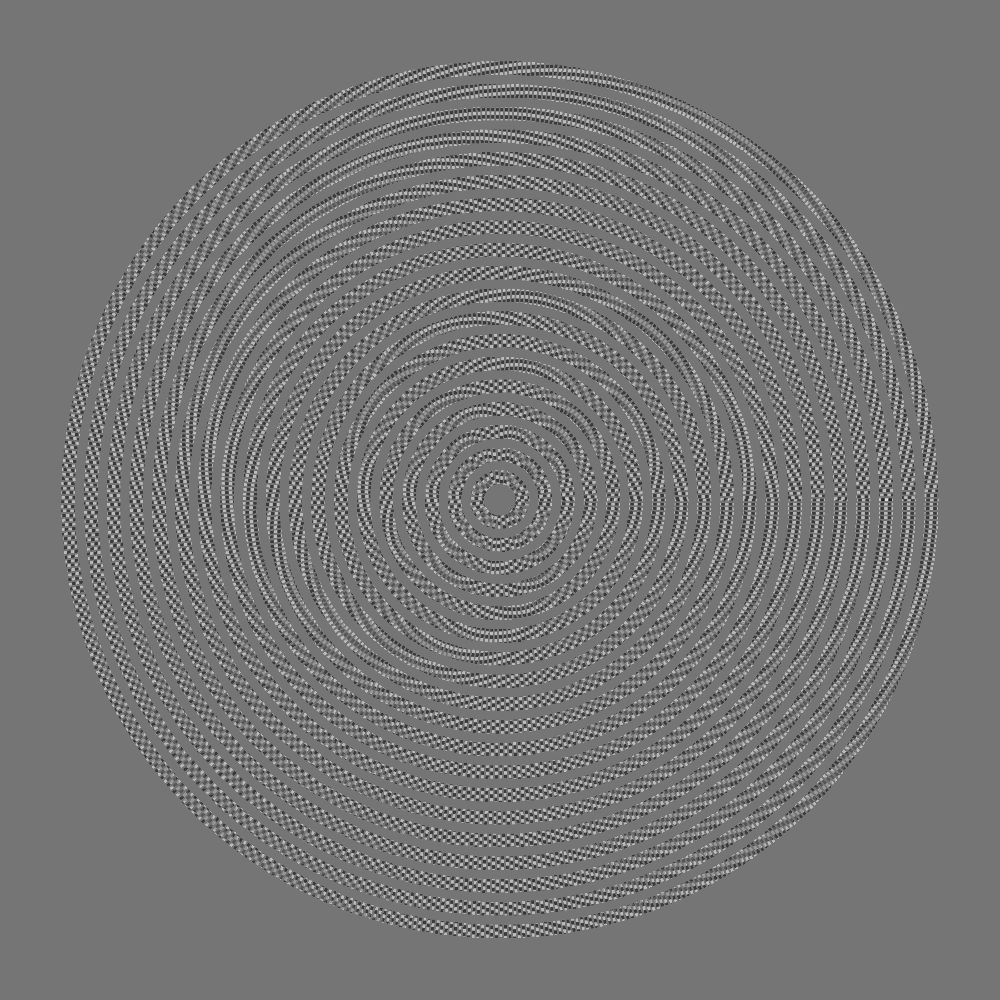

In [315]:
db_width = 2000
db_height = 2000
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2


base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color

center = np.array([int(d/2) for d in base.shape[:2]])

perim_spacing = 10

rads = np.arange(50, 1000, 50)
centers = []
rpts = []
for rad in rads:
    circumference = np.pi * 2 * rad 
    thetas = np.arange(0, circumference, perim_spacing) / rad
    rpts += [RadialPoint(rad=rad, theta=theta) for theta in thetas]
        


for rpt in rpts:
    pt = sa.translate(rpt.pt, xoff=center[0], yoff=center[1])
    x = pt.x
    y = pt.y
    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    theta = -np.degrees(rpt.theta)
    phase = theta ** 2
    gp = Gabor2(
        sigma=18,
        theta=theta,
        lambda_=20,
        amplitude=4,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1,
        background_colour=(bg_color, bg_color, bg_color),
        bbox_size=(30,6)
    )
    
    left = int(x) - int(gp.array.shape[1] / 2)
    right = left + gp.array.shape[1]

    top = int(y) - int(gp.array.shape[0] / 2)
    bottom = top + gp.array.shape[0]
    base[top:bottom, left:right, :] += gp.array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base)

In [316]:
Image.fromarray(base).save('/Users/alexnaka/data/side/gabor_circle.png')

## try 9 bigger

In [340]:
rpt.theta

6.276923076923077

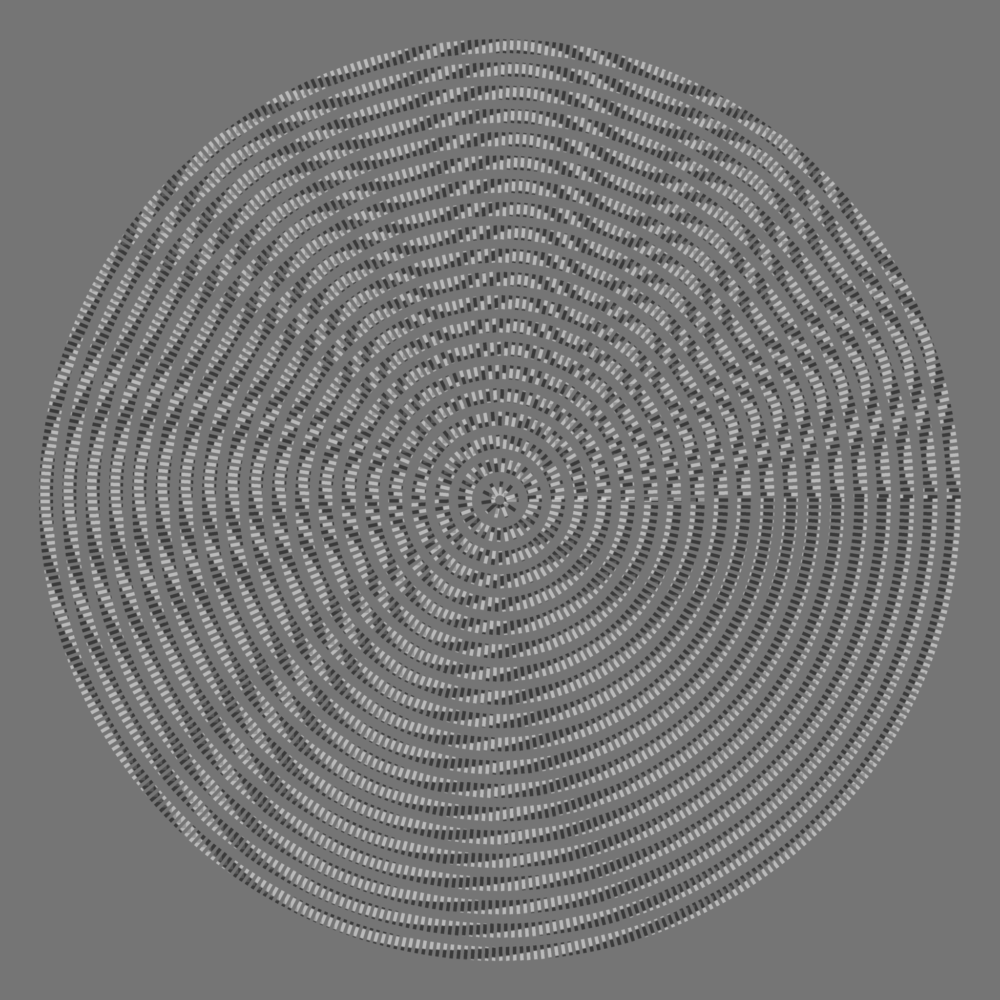

In [372]:
db_width = 4096
db_height = 4096
xpad = 100
ypad = 100
bg_color = 117

padded_canvas_height = db_height + ypad * 2
padded_canvas_width = db_width + xpad * 2


base = np.ones((padded_canvas_height, padded_canvas_width, 3)) * bg_color

center = np.array([int(d/2) for d in base.shape[:2]])

perim_spacing = 30

rads = np.arange(50, 2000, 100)
centers = []
rpts = []
for rad in rads:
    circumference = np.pi * 2 * rad 
    thetas = np.arange(0, circumference, perim_spacing) / rad
    rpts += [RadialPoint(rad=rad, theta=theta) for theta in thetas]
        


for rpt in rpts:
    pt = sa.translate(rpt.pt, xoff=center[0], yoff=center[1])
    x = pt.x
    y = pt.y
    rel_x = np.interp(x, (xpad, db_width+xpad), (0, 1))
    rel_y = np.interp(y, (ypad, db_height+ypad), (0, 1))
    theta = -np.degrees(rpt.theta)
    rad_mod =  np.interp(rpt.rad, (50, 2000), (0, 1))
    phase = np.degrees(np.sin(rpt.theta ** 2 + rad_mod)) * 6 - rad_mod * 39
    gp = Gabor2(
        sigma=10,
        theta=theta,
        lambda_=30,
        amplitude=10,
        phase=phase, 
        gamma=1,  # xy asymmetry?
        nstds=1,
        background_colour=(bg_color, bg_color, bg_color),
        bbox_size=(60,15)
    )
    
    left = int(x) - int(gp.array.shape[1] / 2)
    right = left + gp.array.shape[1]

    top = int(y) - int(gp.array.shape[0] / 2)
    bottom = top + gp.array.shape[0]
    base[top:bottom, left:right, :] += gp.array
    base[top:bottom, left:right, :] *= 0.5
    
base = base.astype(np.uint8)
Image.fromarray(base).resize((2048, 2048))

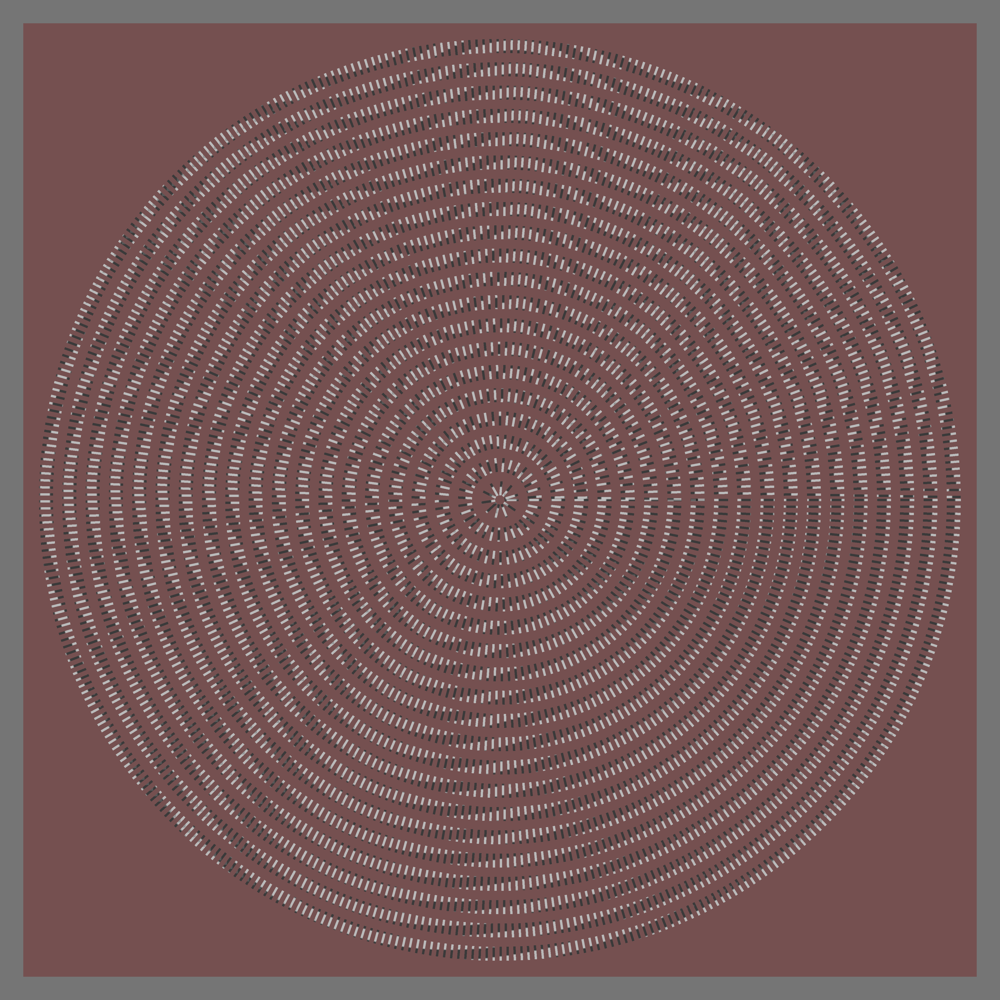

In [371]:
padmask = np.zeros_like(base)
padmask[ypad:-ypad, xpad:-xpad, :] = 1
base_copy = base.copy()
for dim in [1, 2]:
    is_bg = (base_copy[:, :, dim]==bg_color) & (padmask[:, :, dim] == 1)
    base_copy[is_bg, dim] = 80
Image.fromarray(base_copy)


In [358]:
Image.fromarray(base).save('/Users/alexnaka/data/side/gabor_circle6.png')